# STAX pinpointed cell type, domain type, and disease-related specific genes in cell and gene co-embedding

## Load package

In [1]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
import scanpy as sc
import pandas as pd
import numpy as np
import torch
import dgl
import random
from scipy.sparse import csr_matrix
from sklearn.metrics import adjusted_rand_score as ari_score
from sklearn.metrics.cluster import normalized_mutual_info_score

In [4]:
import STA as sta

In [5]:
import os

In [6]:
seed = 42
random.seed(seed)
torch.manual_seed(seed)
torch.cuda.manual_seed_all(seed)
np.random.seed(seed)
dgl.random.seed(seed)

In [7]:
sc.set_figure_params(dpi=300, figsize=(4, 4), frameon=False)    # TODO 是否画边框

## MERFISH cell type

### load data

In [10]:
files = os.listdir('./data/5Co_embedding/MERFISH/')
files = [file.split('.')[0] for file in files]
files

['MERFISH1', 'MERFISH2', 'MERFISH3', 'MERFISH4', 'MERFISH5']

In [11]:
files = ['MERFISH1', 'MERFISH2', 'MERFISH3', 'MERFISH4', 'MERFISH5']

In [12]:
data_list = [sc.read_h5ad(f'./data/5Co_embedding/MERFISH/{file}.h5ad') for file in files]
data_list

[AnnData object with n_obs × n_vars = 5488 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth'
     uns: 'domain_colors'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 5557 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth'
     uns: 'domain_colors'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 5926 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth'
     uns: 'domain_colors'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 5803 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth'
     uns: 'domain_colors'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 5543 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth'
     uns: 'domain_colors'
     obsm: 'spatial']

### Preprocess the data

In [14]:
batch_key = 'batch'
batch_names = files

adata = sta.pp.process_adata(data_list, label=batch_key, keys=batch_names, n_top_features=5000, norm=True, scale='log', target_sum=1e4)
adata

View of AnnData object with n_obs × n_vars = 28317 × 155
    obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth', 'original_index', 'spot_quality', 'batch'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p'
    obsm: 'spatial'
    layers: 'counts', 'norm_log'

In [15]:
adata.obs.loc[:, 'cell_class'].value_counts()

cell_class
Inhibitory       12369
Excitatory        5787
Astrocyte         3406
Endothelial 1     1480
Ependymal         1287
OD Mature 2       1153
OD Immature 1     1012
Microglia          594
Endothelial 3      549
OD Mature 1        238
Pericytes          204
Endothelial 2      144
OD Mature 4         47
OD Immature 2       33
OD Mature 3         14
Name: count, dtype: int64

In [16]:
cell_dict = {'Inhibitory': 'Inhibitory',
 'Excitatory': 'Excitatory',
 'Astrocyte': 'Astrocyte',
 'Endothelial 1': 'Endothelial',
 'Ependymal': 'Ependymal',
 'OD Mature 2': 'Mature oligodendrocyte',
 'OD Immature 1': 'Immature oligodendrocyte',
 'Microglia': 'Microglia',
 'Endothelial 3': 'Endothelial',
 'OD Mature 1': 'Mature oligodendrocyte',
 'Pericytes': 'Pericytes and Mural',
 'Endothelial 2': 'Endothelial',
 'OD Mature 4': 'Mature oligodendrocyte',
 'OD Immature 2': 'Immature oligodendrocyte',
 'OD Mature 3': 'Mature oligodendrocyte'}

In [17]:
adata.obs.loc[:, 'cell_type'] = adata.obs.loc[:, 'cell_class'].apply(lambda x: cell_dict[x])
adata.obs['cell_type'] = adata.obs['cell_type'].astype('category')

In [18]:
adata.obs.loc[:, 'cell_type'].value_counts()

cell_type
Inhibitory                  12369
Excitatory                   5787
Astrocyte                    3406
Endothelial                  2173
Mature oligodendrocyte       1452
Ependymal                    1287
Immature oligodendrocyte     1045
Microglia                     594
Pericytes and Mural           204
Name: count, dtype: int64

### Construct graph

In [19]:
rad_cutoff_list = [0] * len(data_list)
adata, g = sta.pp.process_graph(adata, data_list, cutoff_list=rad_cutoff_list)

cal spatial net in data_list
------Calculating spatial graph...
The graph contains 0 edges, 5488 cells.
0.0000 neighbors per cell on average.
------Calculating spatial graph...
The graph contains 0 edges, 5557 cells.
0.0000 neighbors per cell on average.
------Calculating spatial graph...
The graph contains 0 edges, 5926 cells.
0.0000 neighbors per cell on average.
------Calculating spatial graph...
The graph contains 0 edges, 5803 cells.
0.0000 neighbors per cell on average.
------Calculating spatial graph...
The graph contains 0 edges, 5543 cells.
0.0000 neighbors per cell on average.


### Train

In [20]:
path_results = f'./log/merfish_sc/'

In [21]:
adata_STAX = sta.model.STAX(adata=adata,
                            n_epoch=500,
                            batch_size=len(adata),
                            verbose=False,
                            gpu=0,
                            random_seed=42,
                            output_dir=path_results,
                            )

Epochs: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:24<00:00, 20.70it/s, recon_loss_mse=346.2709, kl_loss=24.5165, lr: 0.0]


### Clustering

In [22]:
sc.pp.neighbors(adata_STAX, use_rep='X_STAX')
sc.tl.umap(adata_STAX)

In [23]:
sc.tl.louvain(adata_STAX, random_state=666, key_added="louvain", resolution=0.5)

In [24]:
sc.tl.leiden(adata_STAX, random_state=666, key_added="leiden", resolution=0.5)

In [25]:
sta.tl.mclust_R(adata_STAX, 9, used_embedding='X_STAX', random_seed=42)

R[write to console]:                    __           __ 
   ____ ___  _____/ /_  _______/ /_
  / __ `__ \/ ___/ / / / / ___/ __/
 / / / / / / /__/ / /_/ (__  ) /_  
/_/ /_/ /_/\___/_/\__,_/____/\__/   version 6.0.0
Type 'citation("mclust")' for citing this R package in publications.



fitting ...
  |======================================================================| 100%


AnnData object with n_obs × n_vars = 28317 × 155
    obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth', 'original_index', 'spot_quality', 'batch', 'cell_type', 'louvain', 'leiden', 'mclust'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'adj', 'neighbors', 'umap', 'louvain', 'leiden'
    obsm: 'spatial', 'X_STAX', 'X_umap', 'mclust_prob'
    varm: 'gene_embedding'
    layers: 'counts', 'norm_log', 'impute'
    obsp: 'distances', 'connectivities'

In [26]:
sta.tl.kmeans_cluster(adata_STAX, mode='KMeans', used_embedding='X_STAX', n_clusters=9)

AnnData object with n_obs × n_vars = 28317 × 155
    obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth', 'original_index', 'spot_quality', 'batch', 'cell_type', 'louvain', 'leiden', 'mclust', 'kmeans'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'adj', 'neighbors', 'umap', 'louvain', 'leiden'
    obsm: 'spatial', 'X_STAX', 'X_umap', 'mclust_prob'
    varm: 'gene_embedding'
    layers: 'counts', 'norm_log', 'impute'
    obsp: 'distances', 'connectivities'

### Visualize Results of full batch

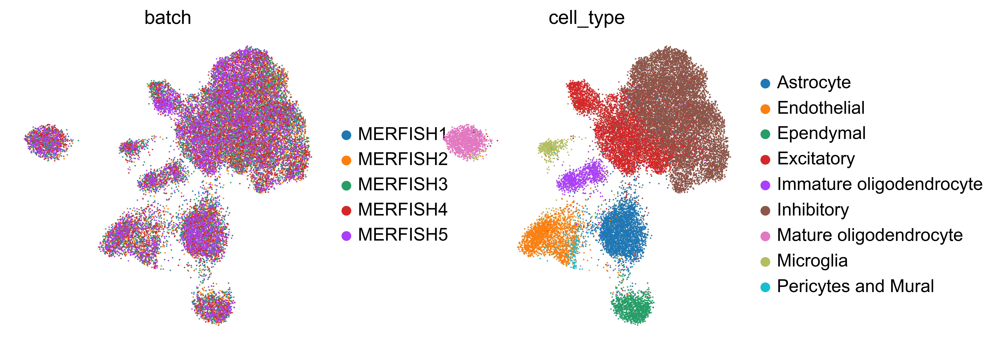

In [27]:
sc.pl.umap(adata_STAX, color=['batch', 'cell_type'], ncols=6)

### cell and gene co_embedding

In [28]:
adata_cell_gene = sta.tl.gene_embedding(adata_STAX, cell_key='X_STAX', gene_key='gene_embedding', T=1e-1)
adata_cell_gene

Performing softmax transformation for query data 0;


AnnData object with n_obs × n_vars = 28472 × 16
    obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth', 'original_index', 'spot_quality', 'batch', 'cell_type', 'louvain', 'leiden', 'mclust', 'kmeans', 'cell_gene', 'id_dataset', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'

In [29]:
sc.pp.neighbors(adata_cell_gene, n_neighbors=50)
sc.tl.umap(adata_cell_gene)

In [30]:
sc.tl.leiden(adata_cell_gene, resolution=0.5)

In [31]:
adata_cell_gene.uns['cell_gene_colors'] = ['#A8CAE8', '#F31329']

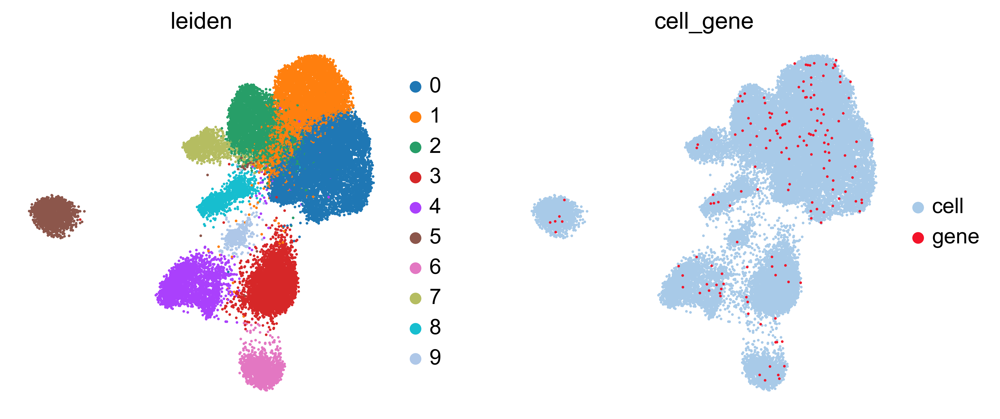

In [32]:
sc.pl.umap(adata_cell_gene, color=['leiden', 'cell_gene'], size=10)

In [36]:
genes = ["Gad1", "Slc17a6", "Ttyh2", "Mbp", "Pdgfra", "Aqp4", "Selplg", "Cd24a", "Fn1", "Myh11"]

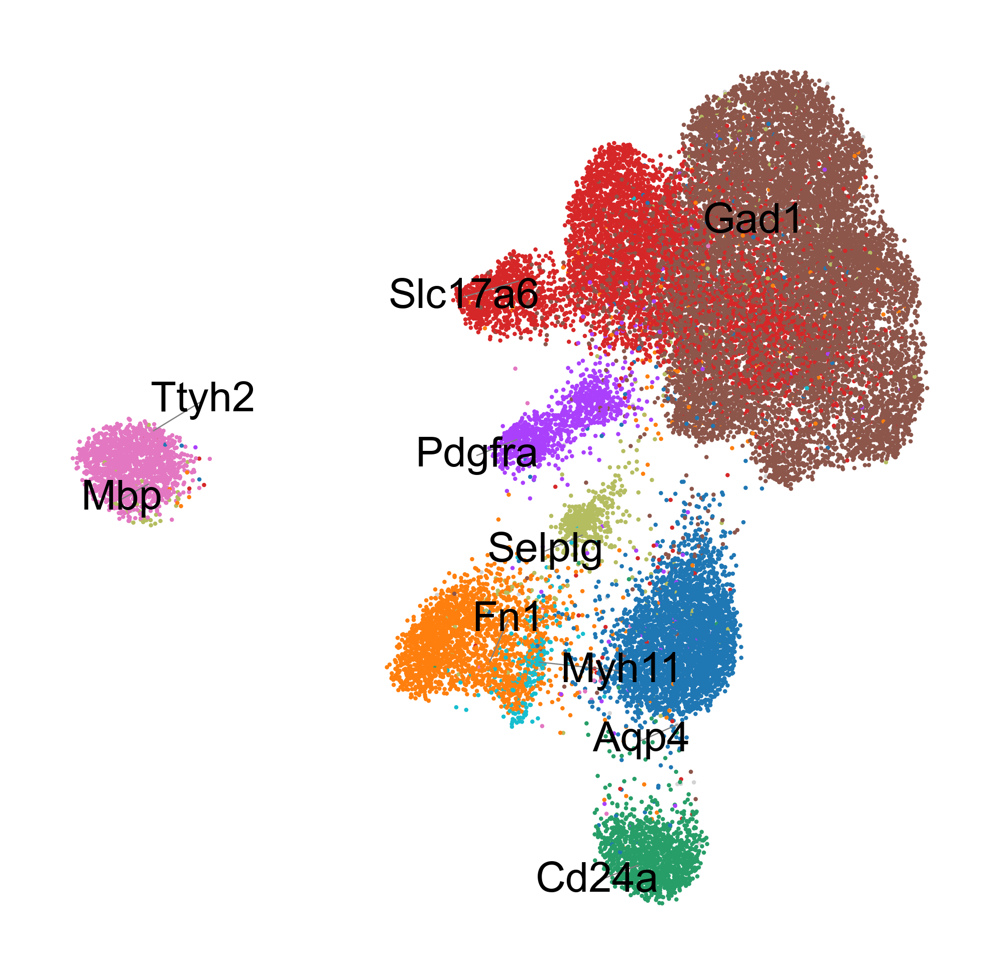

In [37]:
fig = sta.pl.plot_cell_gene(adata_cell_gene, genes, scanpy_color='cell_type', legend_loc=None, title='',)

## MERFISH domain type

### load data

In [38]:
files = os.listdir('./data/5Co_embedding/MERFISH/')
files = [file.split('.')[0] for file in files]
files

['MERFISH1', 'MERFISH2', 'MERFISH3', 'MERFISH4', 'MERFISH5']

In [39]:
files = ['MERFISH1', 'MERFISH2', 'MERFISH3', 'MERFISH4', 'MERFISH5']

In [40]:
data_list = [sc.read_h5ad(f'./data/5Co_embedding/MERFISH/{file}.h5ad') for file in files]
data_list

[AnnData object with n_obs × n_vars = 5488 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth'
     uns: 'domain_colors'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 5557 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth'
     uns: 'domain_colors'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 5926 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth'
     uns: 'domain_colors'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 5803 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth'
     uns: 'domain_colors'
     obsm: 'spatial',
 AnnData object with n_obs × n_vars = 5543 × 155
     obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth'
     uns: 'domain_colors'
     obsm: 'spatial']

### Preprocess the data

In [41]:
batch_key = 'batch'
batch_names = files

adata = sta.pp.process_adata(data_list, label=batch_key, keys=batch_names, n_top_features=5000, norm=True, scale='log', target_sum=1e4)
adata

View of AnnData object with n_obs × n_vars = 28317 × 155
    obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth', 'original_index', 'spot_quality', 'batch'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p'
    obsm: 'spatial'
    layers: 'counts', 'norm_log'

In [42]:
adata.obs.loc[:, 'cell_class'].value_counts()

cell_class
Inhibitory       12369
Excitatory        5787
Astrocyte         3406
Endothelial 1     1480
Ependymal         1287
OD Mature 2       1153
OD Immature 1     1012
Microglia          594
Endothelial 3      549
OD Mature 1        238
Pericytes          204
Endothelial 2      144
OD Mature 4         47
OD Immature 2       33
OD Mature 3         14
Name: count, dtype: int64

In [43]:
cell_dict = {'Inhibitory': 'Inhibitory',
 'Excitatory': 'Excitatory',
 'Astrocyte': 'Astrocyte',
 'Endothelial 1': 'Endothelial',
 'Ependymal': 'Ependymal',
 'OD Mature 2': 'Mature oligodendrocyte',
 'OD Immature 1': 'Immature oligodendrocyte',
 'Microglia': 'Microglia',
 'Endothelial 3': 'Endothelial',
 'OD Mature 1': 'Mature oligodendrocyte',
 'Pericytes': 'Pericytes and Mural',
 'Endothelial 2': 'Endothelial',
 'OD Mature 4': 'Mature oligodendrocyte',
 'OD Immature 2': 'Immature oligodendrocyte',
 'OD Mature 3': 'Mature oligodendrocyte'}

In [44]:
adata.obs.loc[:, 'cell_type'] = adata.obs.loc[:, 'cell_class'].apply(lambda x: cell_dict[x])
adata.obs['cell_type'] = adata.obs['cell_type'].astype('category')

In [45]:
adata.obs.loc[:, 'cell_type'].value_counts()

cell_type
Inhibitory                  12369
Excitatory                   5787
Astrocyte                    3406
Endothelial                  2173
Mature oligodendrocyte       1452
Ependymal                    1287
Immature oligodendrocyte     1045
Microglia                     594
Pericytes and Mural           204
Name: count, dtype: int64

### Construct graph

In [46]:
rad_cutoff_list = [50] * len(data_list)
adata, g = sta.pp.process_graph(adata, data_list, cutoff_list=rad_cutoff_list)

cal spatial net in data_list
------Calculating spatial graph...
The graph contains 74900 edges, 5488 cells.
13.6480 neighbors per cell on average.
------Calculating spatial graph...
The graph contains 80046 edges, 5557 cells.
14.4045 neighbors per cell on average.
------Calculating spatial graph...
The graph contains 86676 edges, 5926 cells.
14.6264 neighbors per cell on average.
------Calculating spatial graph...
The graph contains 83516 edges, 5803 cells.
14.3919 neighbors per cell on average.
------Calculating spatial graph...
The graph contains 75052 edges, 5543 cells.
13.5400 neighbors per cell on average.


### Train

In [47]:
path_results = f'./log/merfish_dt/'

In [48]:
adata_STAX = sta.model.STAX(adata=adata,
                            n_epoch=500,
                            batch_size=len(adata),
                            verbose=False,
                            gpu=0,
                            random_seed=42,
                            output_dir=path_results,
                            )

Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [00:27<00:00, 18.17it/s, recon_loss_mse=495.6450, kl_loss=6.9413, lr: 0.0]


### Clustering

In [49]:
sc.pp.neighbors(adata_STAX, use_rep='X_STAX')
sc.tl.umap(adata_STAX)

In [50]:
sc.tl.louvain(adata_STAX, random_state=666, key_added="louvain", resolution=0.4)

In [51]:
sc.tl.leiden(adata_STAX, random_state=666, key_added="leiden", resolution=0.3)

In [52]:
sta.tl.mclust_R(adata_STAX, 8, used_embedding='X_STAX', random_seed=42)

fitting ...
  |======================================================================| 100%


AnnData object with n_obs × n_vars = 28317 × 155
    obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth', 'original_index', 'spot_quality', 'batch', 'cell_type', 'louvain', 'leiden', 'mclust'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'adj', 'neighbors', 'umap', 'louvain', 'leiden'
    obsm: 'spatial', 'X_STAX', 'X_umap', 'mclust_prob'
    varm: 'gene_embedding'
    layers: 'counts', 'norm_log', 'impute'
    obsp: 'distances', 'connectivities'

In [53]:
sta.tl.kmeans_cluster(adata_STAX, mode='KMeans', used_embedding='X_STAX', n_clusters=8)

AnnData object with n_obs × n_vars = 28317 × 155
    obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth', 'original_index', 'spot_quality', 'batch', 'cell_type', 'louvain', 'leiden', 'mclust', 'kmeans'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'adj', 'neighbors', 'umap', 'louvain', 'leiden'
    obsm: 'spatial', 'X_STAX', 'X_umap', 'mclust_prob'
    varm: 'gene_embedding'
    layers: 'counts', 'norm_log', 'impute'
    obsp: 'distances', 'connectivities'

### Visualize Results of full batch

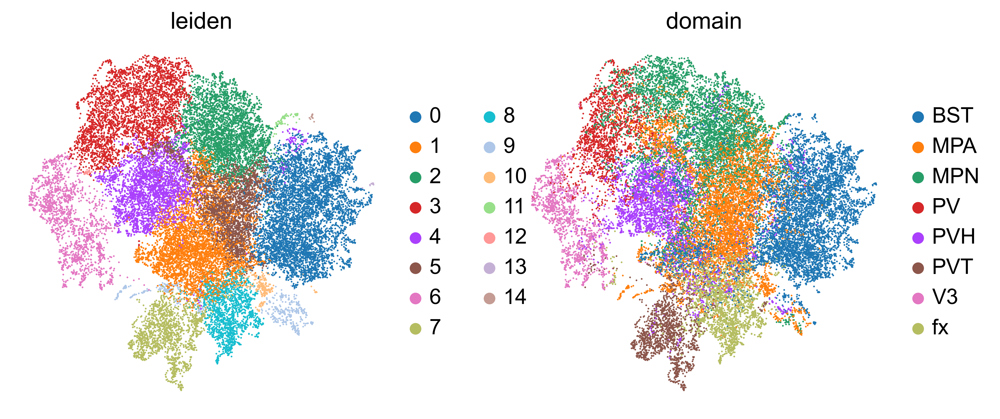

In [64]:
sc.pl.umap(adata_STAX, color=['leiden', 'domain'], ncols=6)

### cell and gene co_embedding

In [55]:
adata_cell_gene = sta.tl.gene_embedding(adata_STAX, cell_key='X_STAX', gene_key='gene_embedding', T=1e-1)
adata_cell_gene

Performing softmax transformation for query data 0;


AnnData object with n_obs × n_vars = 28472 × 16
    obs: 'cell_class', 'neuron_class', 'domain', 'Region', 'ground_truth', 'original_index', 'spot_quality', 'batch', 'cell_type', 'louvain', 'leiden', 'mclust', 'kmeans', 'cell_gene', 'id_dataset', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'

In [56]:
sc.pp.neighbors(adata_cell_gene, n_neighbors=50)
sc.tl.umap(adata_cell_gene)

In [57]:
sc.tl.leiden(adata_cell_gene, resolution=0.5)

In [58]:
adata_cell_gene.uns['cell_gene_colors'] = ['#A8CAE8', '#F31329']

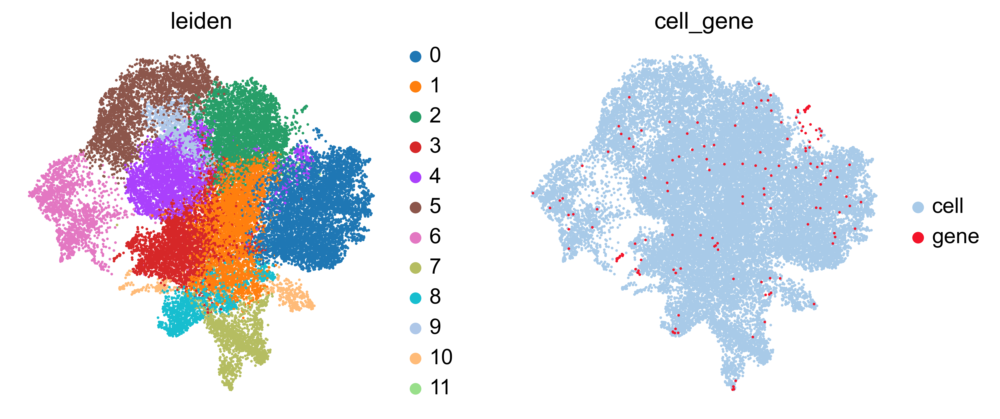

In [65]:
sc.pl.umap(adata_cell_gene, color=['leiden', 'cell_gene'], size=10)

In [60]:
genes = ["Sytl4", "Cd24a", "Slc18a2", "Necab1", "Nts", "Mbp"]

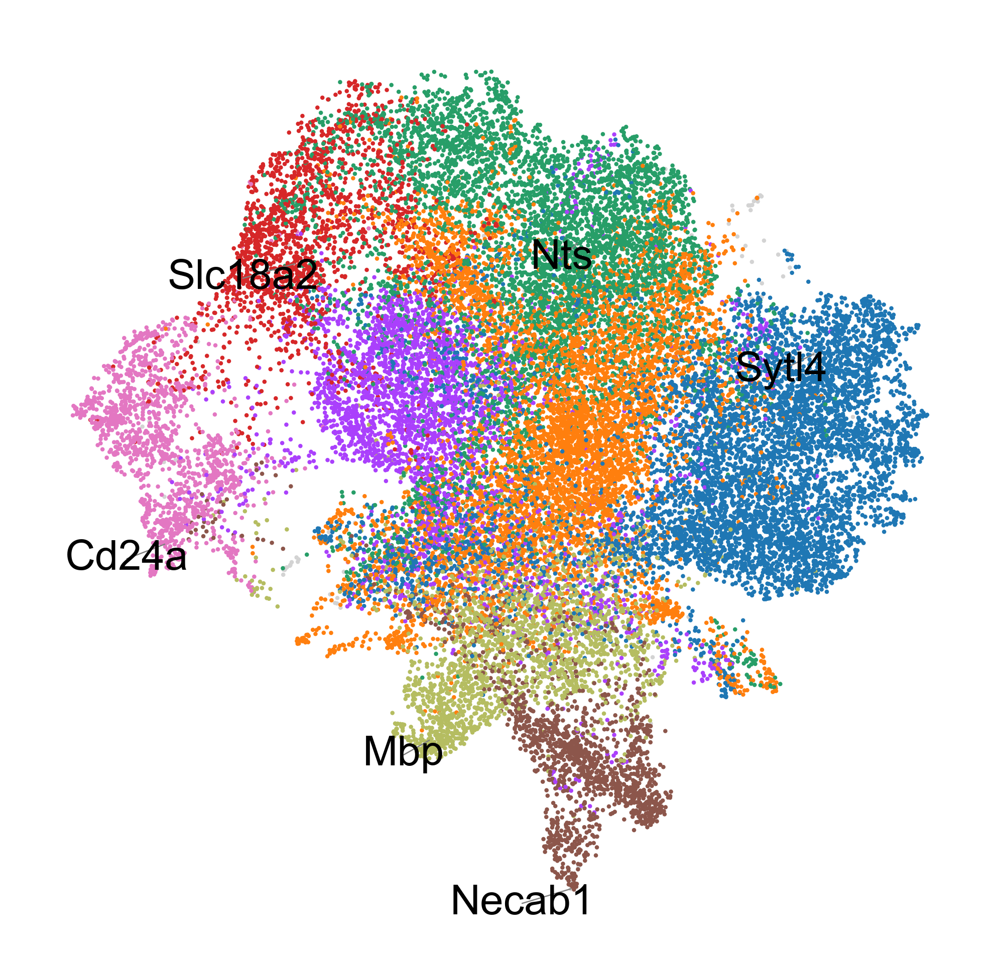

In [62]:
fig = sta.pl.plot_cell_gene(adata_cell_gene, genes, scanpy_color='domain', legend_loc=None, title='',)

## MERFISH domain type

### load data

In [9]:
adata1 = sc.read_h5ad(f'./data/5Co_embedding/MouseBrainAD/Hippocampus_disease_celltype.h5ad')
adata1.obs_names_make_unique()
adata1.var_names_make_unique()
adata1

AnnData object with n_obs × n_vars = 15092 × 14622
    obs: 'batch_name', 'louvain', 'cell_type'
    var: 'n_cells', 'mt'
    uns: 'cell_type_colors'
    obsm: 'spatial'

In [10]:
adata1.X.max()

506.0

In [11]:
adata2 = sc.read_h5ad(f'./data/5Co_embedding/MouseBrainAD/Hippocampus_normal_celltype.h5ad')
adata2.obs_names_make_unique()
adata2.var_names_make_unique()
adata2

AnnData object with n_obs × n_vars = 12822 × 14622
    obs: 'batch_name', 'louvain', 'cell_type'
    var: 'n_cells', 'mt'
    uns: 'louvain_colors'
    obsm: 'spatial'

In [13]:
adata2.X.max()

66.0

### Preprocess the data

In [14]:
data_list = [adata1, adata2]
batch_key = 'batch'
batch_names = ['adata1', 'adata2']

adata = sta.pp.process_adata(data_list, label=batch_key, keys=batch_names, n_top_features=5000, norm=True, scale='log', target_sum=1e4)
adata

View of AnnData object with n_obs × n_vars = 27914 × 5000
    obs: 'batch_name', 'louvain', 'cell_type', 'original_index', 'spot_quality', 'batch'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p'
    obsm: 'spatial'
    layers: 'counts', 'norm_log'

In [15]:
adata.X.max()

7.7291756

### Construct graph

In [16]:
rad_cutoff_list = [20, 30]
adata, g = sta.pp.process_graph(adata, data_list, cutoff_list=rad_cutoff_list)

cal spatial net in data_list
------Calculating spatial graph...
The graph contains 43938 edges, 15092 cells.
2.9113 neighbors per cell on average.
------Calculating spatial graph...
The graph contains 27318 edges, 12822 cells.
2.1306 neighbors per cell on average.


### Train

In [17]:
path_results = f'./log/integration/'

In [18]:
adata_STAX = sta.model.STAX(adata=adata,
                            n_epoch=500,
                            batch_size=len(adata),
                            verbose=False,
                            gpu=0,
                            random_seed=42,
                            output_dir=path_results,
                            )

Epochs: 100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 500/500 [02:32<00:00,  3.28it/s, recon_loss_mse=727.8628, kl_loss=9.5547, lr: 0.0]


### Clustering

In [19]:
sc.pp.neighbors(adata_STAX, use_rep='X_STAX')

In [20]:
sc.tl.louvain(adata_STAX, random_state=666, key_added="louvain", resolution=1)

In [21]:
sc.tl.leiden(adata_STAX, random_state=666, key_added="leiden", resolution=1)

In [22]:
sta.tl.kmeans_cluster(adata_STAX, mode='KMeans', used_embedding='X_STAX', n_clusters=15)

AnnData object with n_obs × n_vars = 27914 × 5000
    obs: 'batch_name', 'louvain', 'cell_type', 'original_index', 'spot_quality', 'batch', 'leiden', 'kmeans'
    var: 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'log1p', 'adj', 'neighbors', 'louvain', 'leiden'
    obsm: 'spatial', 'X_STAX'
    varm: 'gene_embedding'
    layers: 'counts', 'norm_log', 'impute'
    obsp: 'distances', 'connectivities'

In [23]:
sc.tl.umap(adata_STAX)

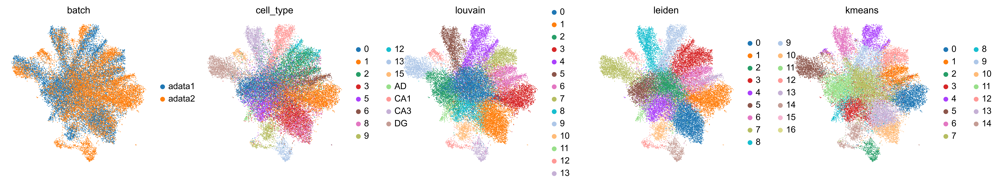

In [24]:
sc.pl.umap(adata_STAX, color=['batch', 'cell_type', 'louvain', 'leiden', 'kmeans'], ncols=5)

## cell and gene co_embedding

In [25]:
adata_cell_gene = sta.tl.gene_embedding(adata_STAX, cell_key='X_STAX', gene_key='gene_embedding', T=1e-1)
adata_cell_gene

Performing softmax transformation for query data 0;


AnnData object with n_obs × n_vars = 32914 × 16
    obs: 'batch_name', 'louvain', 'cell_type', 'original_index', 'spot_quality', 'batch', 'leiden', 'kmeans', 'cell_gene', 'id_dataset', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'

In [26]:
sc.pp.neighbors(adata_cell_gene, n_neighbors=50)

In [27]:
sc.tl.umap(adata_cell_gene)

In [28]:
adata_cell_gene.uns['cell_gene_colors'] = ['#A8CAE8', '#F31329']

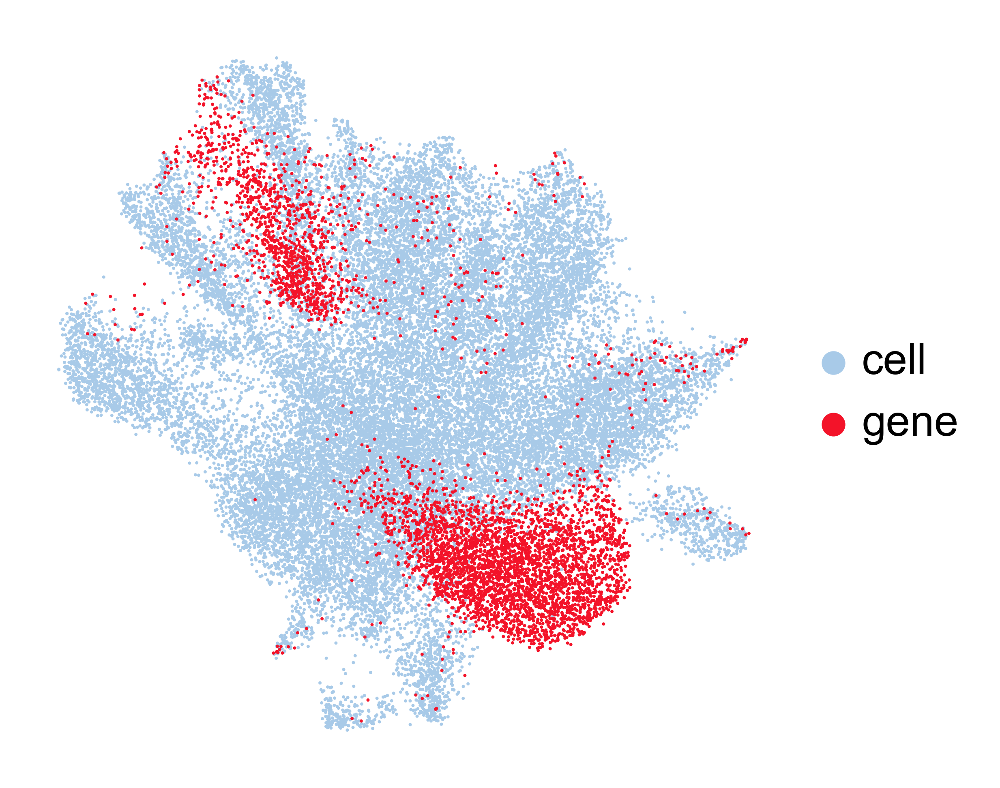

In [29]:
fig = sta.pl.plot_cell_gene(adata_cell_gene, None, 'cell_gene')

In [30]:
sc.tl.louvain(adata_cell_gene, random_state=666, key_added="louvain", resolution=1)

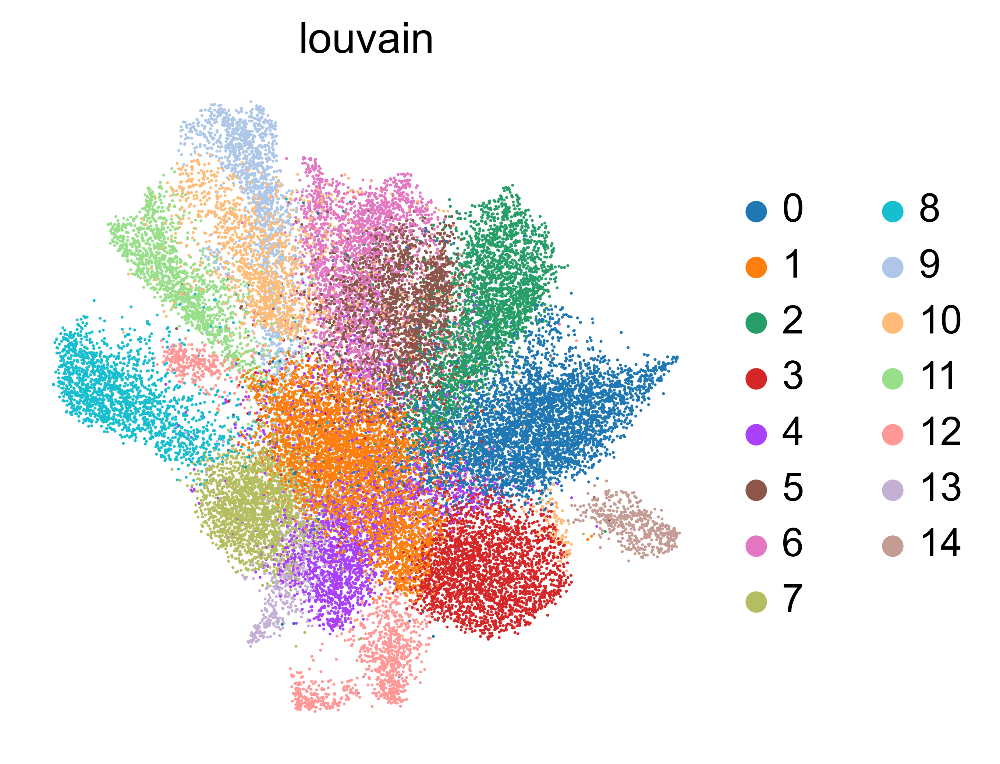

In [32]:
sc.pl.umap(adata_cell_gene, color=['louvain'])

In [33]:
adata_cell_gene_sub = adata_cell_gene[~adata_cell_gene.obs.loc[:, 'louvain'].isin(['3', '10']), :]
adata_cell_gene_sub

View of AnnData object with n_obs × n_vars = 28745 × 16
    obs: 'batch_name', 'louvain', 'cell_type', 'original_index', 'spot_quality', 'batch', 'leiden', 'kmeans', 'cell_gene', 'id_dataset', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'neighbors', 'umap', 'cell_gene_colors', 'louvain', 'leiden', 'louvain_colors'
    obsm: 'X_umap'
    obsp: 'distances', 'connectivities'

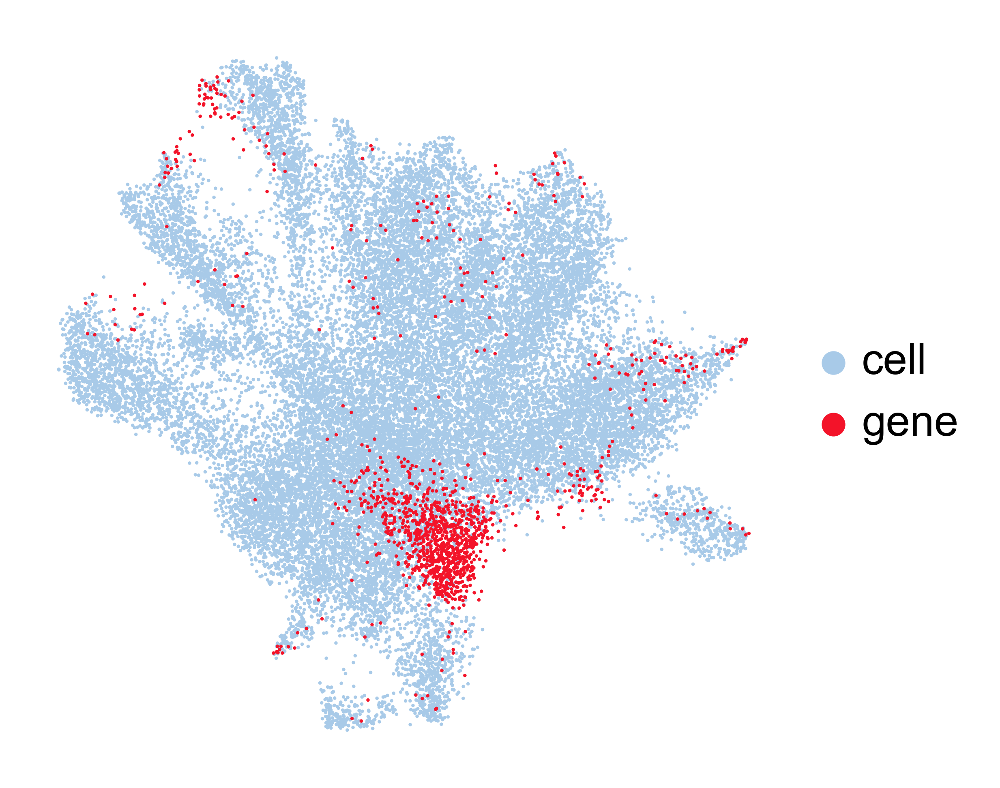

In [34]:
fig = sta.pl.plot_cell_gene(adata_cell_gene_sub, None, 'cell_gene')

### DG, CA1, CA3

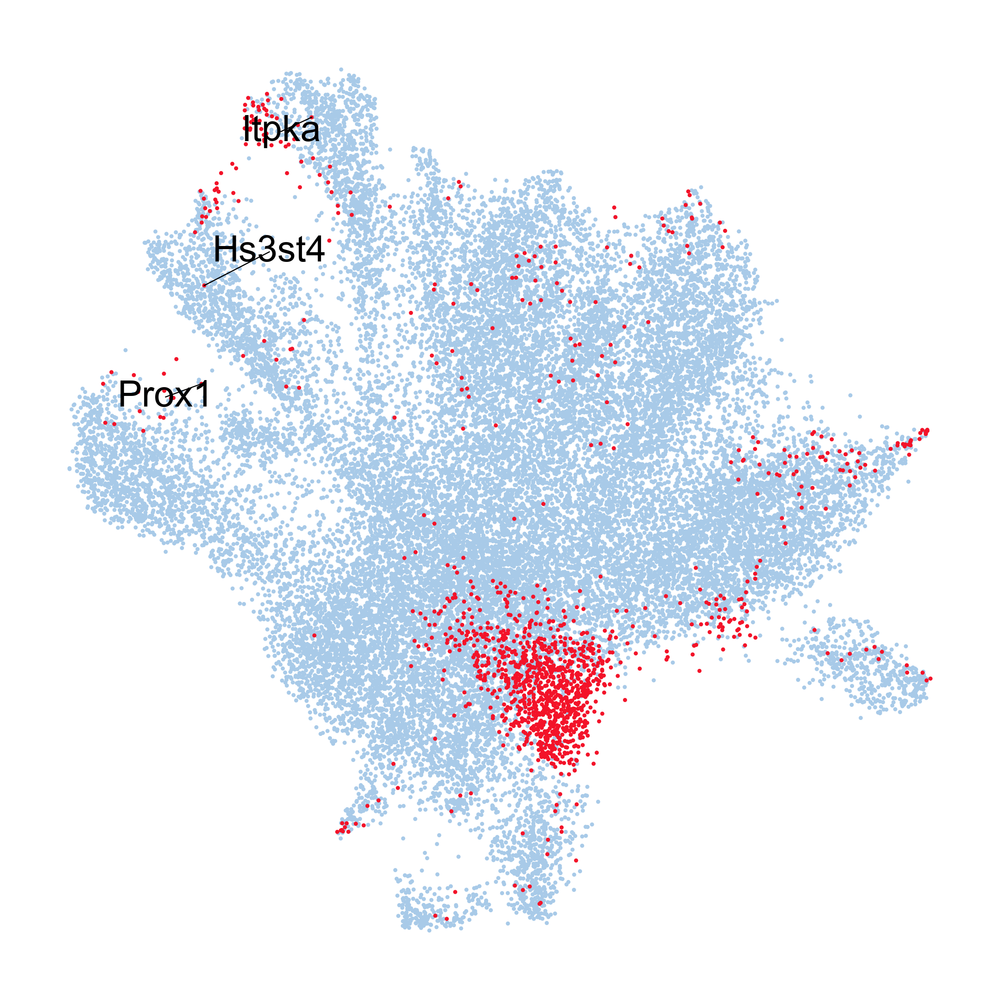

In [35]:
fig = sta.pl.clear_fig(sta.pl.plot_cell_gene(adata_cell_gene_sub, ['Itpka', 'Hs3st4', 'Prox1'], 'cell_gene', legend_loc=None, size=5, line_width=0.3, line_color='black'))
# fig.savefig(f'./pipeline_my/st_cell_gene_DG_CA_markers_3.jpg', bbox_inches='tight', dpi=300)

### AD, domain13

In [36]:
adata_cell_gene_sub13 = adata_cell_gene_sub[adata_cell_gene_sub.obs.loc[:, 'louvain'] == '13', :]
adata_cell_gene_sub13

View of AnnData object with n_obs × n_vars = 636 × 16
    obs: 'batch_name', 'louvain', 'cell_type', 'original_index', 'spot_quality', 'batch', 'leiden', 'kmeans', 'cell_gene', 'id_dataset', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'neighbors', 'umap', 'cell_gene_colors', 'louvain', 'leiden', 'louvain_colors'
    obsm: 'X_umap'
    obsp: 'distances', 'connectivities'

#### select genes in domain 13

In [37]:
adata_cell_gene_sub13 = adata_cell_gene_sub13[adata_cell_gene_sub13.obs.loc[:, 'cell_gene'] == 'gene', :]
adata_cell_gene_sub13

View of AnnData object with n_obs × n_vars = 17 × 16
    obs: 'batch_name', 'louvain', 'cell_type', 'original_index', 'spot_quality', 'batch', 'leiden', 'kmeans', 'cell_gene', 'id_dataset', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches'
    uns: 'neighbors', 'umap', 'cell_gene_colors', 'louvain', 'leiden', 'louvain_colors'
    obsm: 'X_umap'
    obsp: 'distances', 'connectivities'

In [38]:
adata_cell_gene_sub13.obs.index

Index(['C1qa', 'C1qb', 'C1qc', 'Cbln4', 'Cmss1', 'Csf1r', 'Ctsd', 'Ctss',
       'Cx3cr1', 'Fcgr3', 'Fcrls', 'Gfap', 'Hexb', 'Laptm5', 'P2ry12',
       'Tmem119', 'Trem2'],
      dtype='object')

In [39]:
deg = adata_cell_gene_sub13.obs.index.tolist()

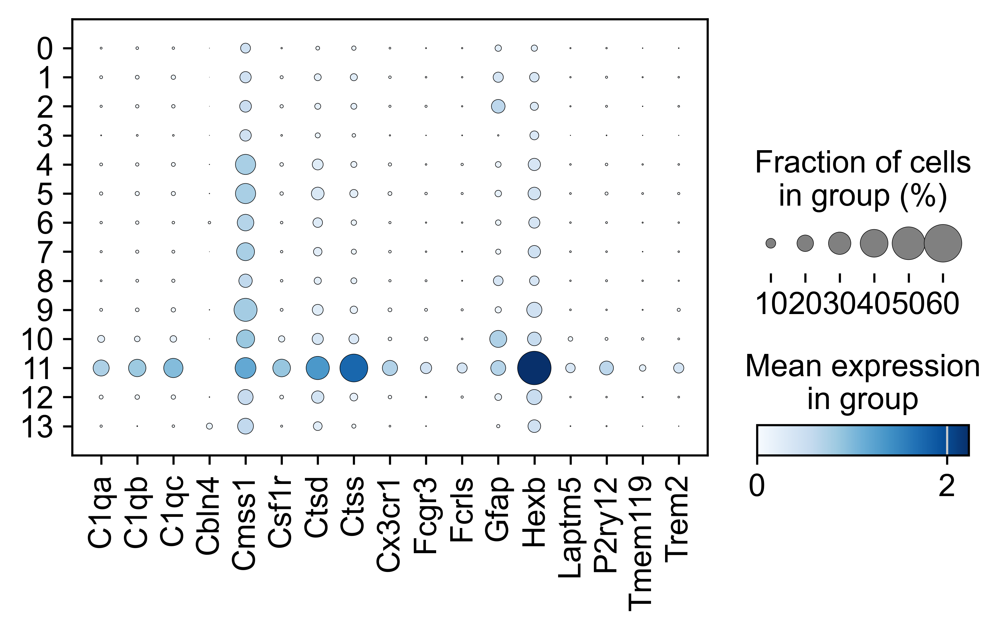

In [41]:
sc.pl.dotplot(adata_STAX, deg, groupby="louvain", figsize=(6, 3), cmap='Blues');

#### use networkx to get clustering_coefficient

In [43]:
import networkx as nx

In [44]:
adata_cell_gene_sub13.obs

,batch_name,louvain,cell_type,original_index,spot_quality,batch,leiden,kmeans,cell_gene,id_dataset,highly_variable,highly_variable_rank,means,variances,variances_norm,highly_variable_nbatches
C1qa,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,1023.0,0.027012,0.046059,1.107639,1.0
C1qb,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,2267.0,0.035968,0.063981,1.154726,2.0
C1qc,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,470.0,0.041771,0.087174,1.189325,1.0
Cbln4,NaN,13,NaN,NaN,NaN,NaN,2,NaN,gene,query_0,True,1802.0,0.003332,0.004180,1.122484,2.0
Cmss1,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,349.5,0.303002,1.425544,1.631767,2.0
Csf1r,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,557.0,0.032923,0.063868,1.349358,2.0
Ctsd,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,102.0,0.116644,0.401326,1.507476,1.0
Ctss,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,152.0,0.095687,0.289737,1.756120,2.0
Cx3cr1,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,1091.0,0.029734,0.058945,1.282510,2.0
Fcgr3,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,2596.0,0.015440,0.022009,1.026045,1.0


In [45]:
G = nx.from_scipy_sparse_array(adata_cell_gene_sub13.obsp['connectivities'])

In [46]:
clustering_coefficient = nx.clustering(G)

In [47]:
temp = adata_cell_gene_sub13.copy()
temp.obs.loc[:, 'clustering_coefficient'] = list(clustering_coefficient.values())
temp

AnnData object with n_obs × n_vars = 17 × 16
    obs: 'batch_name', 'louvain', 'cell_type', 'original_index', 'spot_quality', 'batch', 'leiden', 'kmeans', 'cell_gene', 'id_dataset', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'clustering_coefficient'
    uns: 'neighbors', 'umap', 'cell_gene_colors', 'louvain', 'leiden', 'louvain_colors'
    obsm: 'X_umap'
    obsp: 'distances', 'connectivities'

In [48]:
temp_gene = temp[temp.obs.loc[:, 'cell_gene'] == 'gene', :].copy()
temp_gene

AnnData object with n_obs × n_vars = 17 × 16
    obs: 'batch_name', 'louvain', 'cell_type', 'original_index', 'spot_quality', 'batch', 'leiden', 'kmeans', 'cell_gene', 'id_dataset', 'highly_variable', 'highly_variable_rank', 'means', 'variances', 'variances_norm', 'highly_variable_nbatches', 'clustering_coefficient'
    uns: 'neighbors', 'umap', 'cell_gene_colors', 'louvain', 'leiden', 'louvain_colors'
    obsm: 'X_umap'
    obsp: 'distances', 'connectivities'

In [49]:
temp_gene.obs.sort_values(by='clustering_coefficient', ascending=False)

,batch_name,louvain,cell_type,original_index,spot_quality,batch,leiden,kmeans,cell_gene,id_dataset,highly_variable,highly_variable_rank,means,variances,variances_norm,highly_variable_nbatches,clustering_coefficient
Hexb,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,325.0,0.181343,0.507077,1.516010,2.0,1.000000
Gfap,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,2623.0,0.095400,0.149498,0.931553,1.0,1.000000
C1qa,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,1023.0,0.027012,0.046059,1.107639,1.0,0.977778
Ctss,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,152.0,0.095687,0.289737,1.756120,2.0,0.977778
C1qb,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,2267.0,0.035968,0.063981,1.154726,2.0,0.977778
Cx3cr1,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,1091.0,0.029734,0.058945,1.282510,2.0,0.977778
Csf1r,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,557.0,0.032923,0.063868,1.349358,2.0,0.977778
C1qc,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,470.0,0.041771,0.087174,1.189325,1.0,0.977778
P2ry12,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,892.0,0.021101,0.040933,1.299250,2.0,0.854545
Ctsd,NaN,13,NaN,NaN,NaN,NaN,14,NaN,gene,query_0,True,102.0,0.116644,0.401326,1.507476,1.0,0.763636


In [50]:
markers = temp_gene.obs.sort_values(by='clustering_coefficient', ascending=False).index.tolist()
markers

['Hexb',
 'Gfap',
 'C1qa',
 'Ctss',
 'C1qb',
 'Cx3cr1',
 'Csf1r',
 'C1qc',
 'P2ry12',
 'Ctsd',
 'Fcrls',
 'Trem2',
 'Laptm5',
 'Fcgr3',
 'Tmem119',
 'Cmss1',
 'Cbln4']

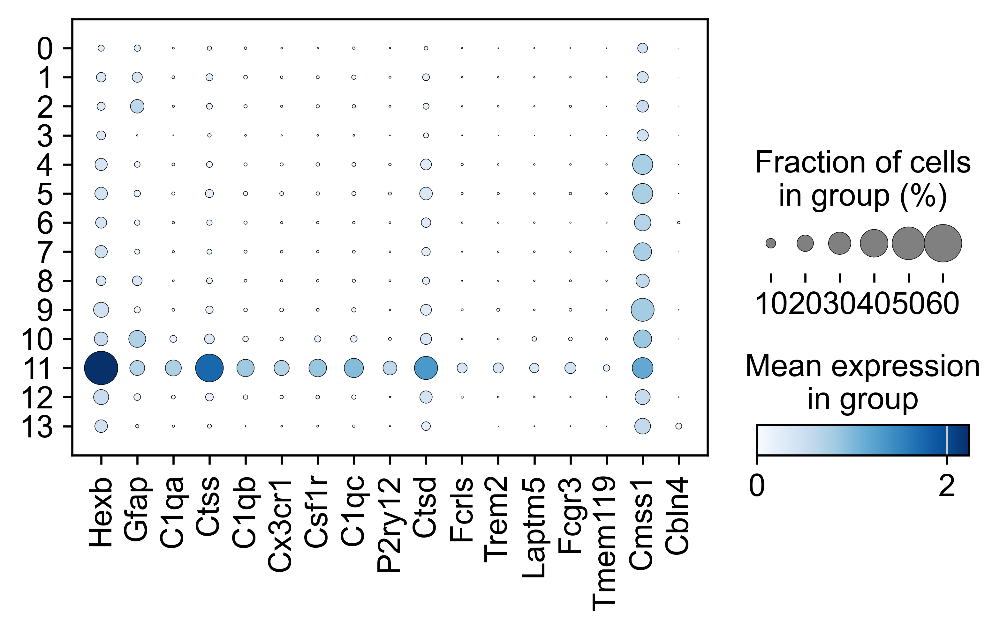

In [51]:
sc.pl.dotplot(adata_STAX, markers, groupby="louvain", figsize=(6, 3), cmap='Blues');

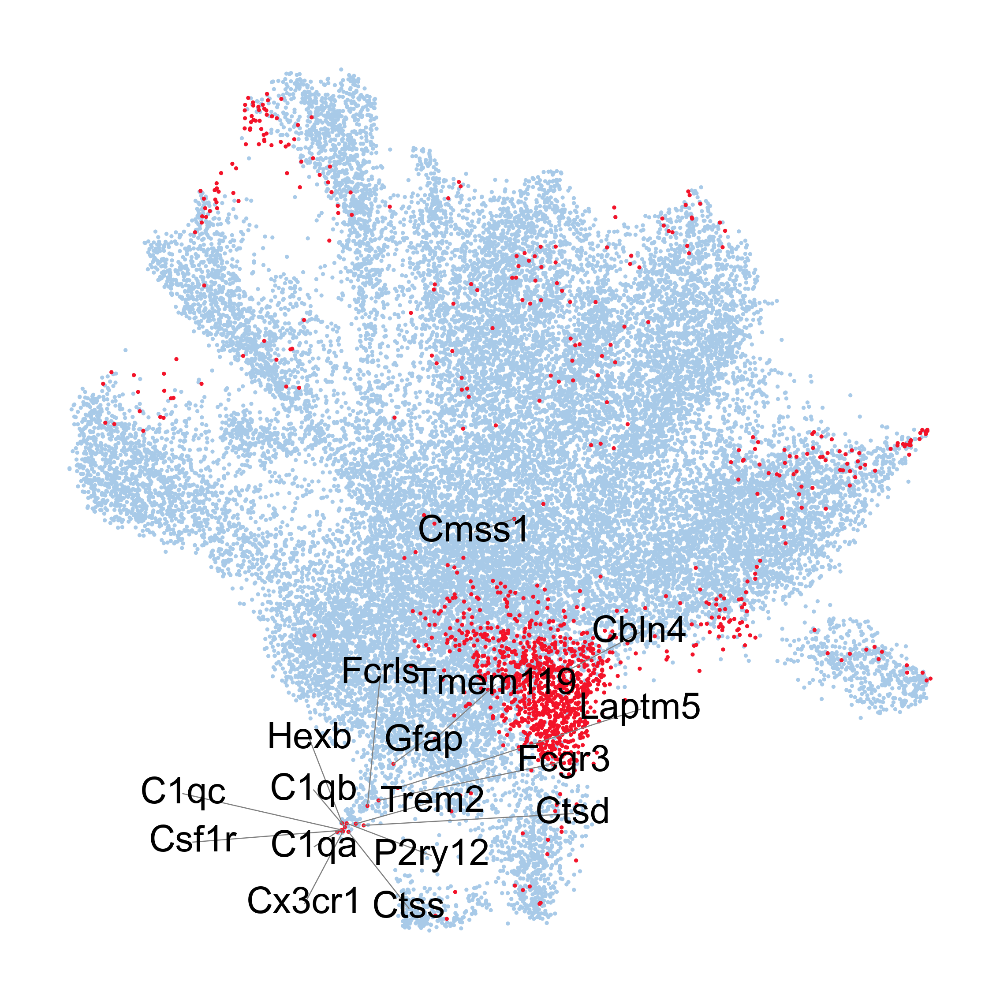

In [52]:
fig = sta.pl.clear_fig(sta.pl.plot_cell_gene(adata_cell_gene_sub, markers, 'cell_gene', legend_loc=None, size=5))
# fig.savefig(f'./pipeline_my/st_cell_gene_domain13ADmarkers_all.jpg', bbox_inches='tight')

In [53]:
markers_sub = temp_gene.obs.sort_values(by='clustering_coefficient', ascending=False).head(8).index.tolist()
markers_sub

['Hexb', 'Gfap', 'C1qa', 'Ctss', 'C1qb', 'Cx3cr1', 'Csf1r', 'C1qc']

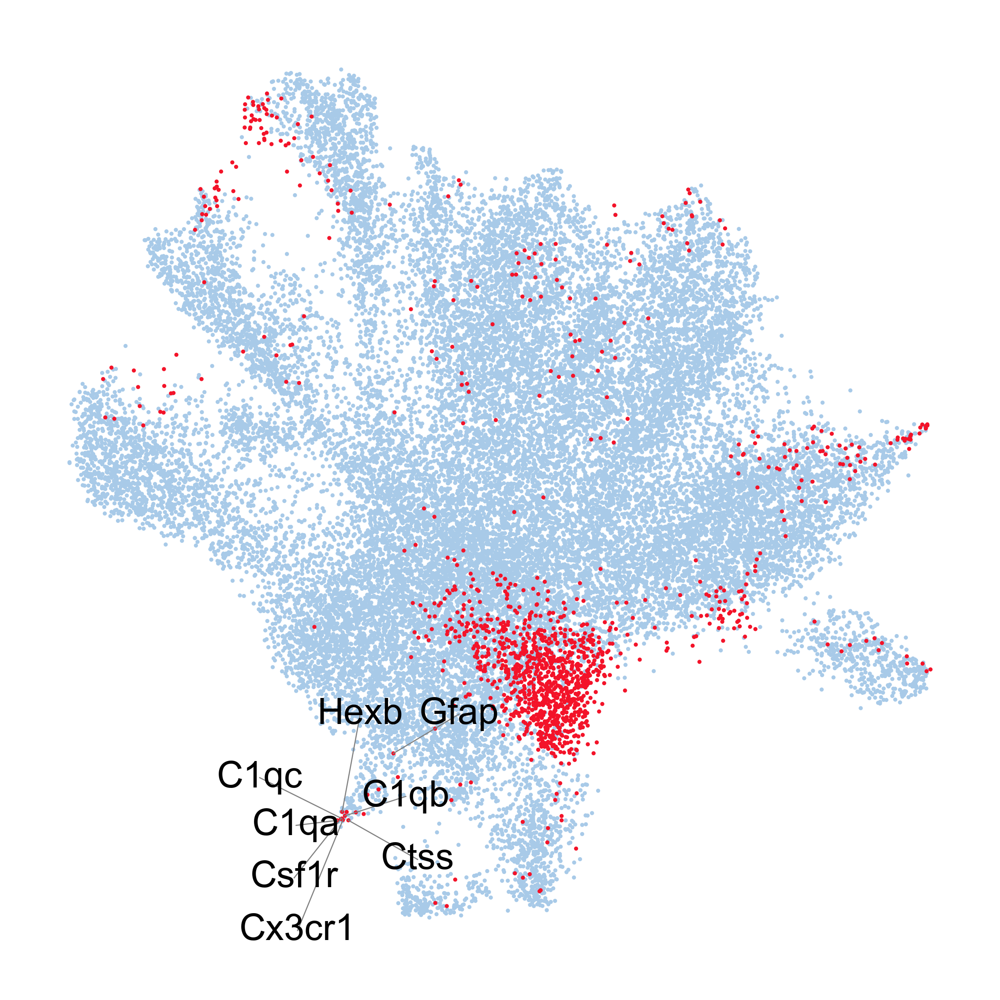

In [54]:
fig = sta.pl.clear_fig(sta.pl.plot_cell_gene(adata_cell_gene_sub, markers_sub, 'cell_gene', legend_loc=None,size=5))
# fig.savefig(f'./pipeline_my/st_cell_gene_domain13ADmarkers_sub.jpg', bbox_inches='tight')